In [1]:
import datetime

In [2]:
import pandas as pd
import numpy as np

In [3]:
df = pd.read_csv('NYCTaxiFares.csv')

In [4]:
df.head()

,pickup_datetime,fare_amount,fare_class,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2010-04-19 08:17:56 UTC,6.5,0,-73.992365,40.730521,-73.975499,40.744746,1
1,2010-04-17 15:43:53 UTC,6.9,0,-73.990078,40.740558,-73.974232,40.744114,1
2,2010-04-17 11:23:26 UTC,10.1,1,-73.994149,40.751118,-73.960064,40.766235,2
3,2010-04-11 21:25:03 UTC,8.9,0,-73.990485,40.756422,-73.971205,40.748192,1
4,2010-04-17 02:19:01 UTC,19.7,1,-73.990976,40.734202,-73.905956,40.743115,1


In [5]:
df.shape

(120000, 8)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 120000 entries, 0 to 119999
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   pickup_datetime    120000 non-null  object 
 1   fare_amount        120000 non-null  float64
 2   fare_class         120000 non-null  int64  
 3   pickup_longitude   120000 non-null  float64
 4   pickup_latitude    120000 non-null  float64
 5   dropoff_longitude  120000 non-null  float64
 6   dropoff_latitude   120000 non-null  float64
 7   passenger_count    120000 non-null  int64  
dtypes: float64(5), int64(2), object(1)
memory usage: 7.3+ MB


### Feature Engineering

In [7]:
pd.to_datetime(df['pickup_datetime'])

0        2010-04-19 08:17:56+00:00
1        2010-04-17 15:43:53+00:00
2        2010-04-17 11:23:26+00:00
3        2010-04-11 21:25:03+00:00
4        2010-04-17 02:19:01+00:00
                    ...           
119995   2010-04-18 14:33:03+00:00
119996   2010-04-23 10:27:48+00:00
119997   2010-04-18 18:50:40+00:00
119998   2010-04-13 08:14:44+00:00
119999   2010-04-17 16:00:14+00:00
Name: pickup_datetime, Length: 120000, dtype: datetime64[ns, UTC]

In [8]:
# Converting UTC to NYC time.

df['pickup_datetime'] = pd.to_datetime(df['pickup_datetime'])-datetime.timedelta(hours=4)

In [9]:
df.head()

,pickup_datetime,fare_amount,fare_class,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2010-04-19 04:17:56+00:00,6.5,0,-73.992365,40.730521,-73.975499,40.744746,1
1,2010-04-17 11:43:53+00:00,6.9,0,-73.990078,40.740558,-73.974232,40.744114,1
2,2010-04-17 07:23:26+00:00,10.1,1,-73.994149,40.751118,-73.960064,40.766235,2
3,2010-04-11 17:25:03+00:00,8.9,0,-73.990485,40.756422,-73.971205,40.748192,1
4,2010-04-16 22:19:01+00:00,19.7,1,-73.990976,40.734202,-73.905956,40.743115,1


In [10]:
df['Year'] = df['pickup_datetime'].dt.year
df['Month'] = df['pickup_datetime'].dt.month
df['Day'] = df['pickup_datetime'].dt.day
df['Hours'] = df['pickup_datetime'].dt.hour
df['Mins'] = df['pickup_datetime'].dt.minute

In [11]:
df['pickup_datetime'].dt.minute

0         17
1         43
2         23
3         25
4         19
          ..
119995    33
119996    27
119997    50
119998    14
119999     0
Name: pickup_datetime, Length: 120000, dtype: int64

In [12]:
df['am_pm'] = np.where(df['Hours'] < 12, 0, 1)

In [13]:
from sklearn.metrics.pairwise import haversine_distances
from math import radians
biratnagar = [40.730521, -73.992365]
chitwan = [40.744746, -73.975499]
biratnagar_in_radians = [radians(_) for _ in biratnagar]
chitwan_in_radians = [radians(_) for _ in chitwan]
result = haversine_distances([biratnagar_in_radians, chitwan_in_radians])
result * 6371000/1000  # multiply by Earth radius to get kilometers

array([[0.        , 2.12631159],
       [2.12631159, 0.        ]])

In [14]:
result[0,1]

0.0003337484830762392

In [15]:
distance = np.array([])
for i in range(120000):
    pickup_loc = [df['pickup_latitude'][i], df['pickup_longitude'][i]]
    dropoff_loc = [df['dropoff_latitude'][i], df['dropoff_longitude'][i]]
    pickup_in_radian = [radians(_) for _ in pickup_loc]
    dropoff_in_radian = [radians(_) for _ in dropoff_loc]
    result = haversine_distances([pickup_in_radian, dropoff_in_radian]) * 6371
    result = result[0,1]
    distance = np.append(distance, result)
    
df['Distance_km'] = distance

In [16]:
df.head()

,pickup_datetime,fare_amount,fare_class,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Year,Month,Day,Hours,Mins,am_pm,Distance_km
0,2010-04-19 04:17:56+00:00,6.5,0,-73.992365,40.730521,-73.975499,40.744746,1,2010,4,19,4,17,0,2.126312
1,2010-04-17 11:43:53+00:00,6.9,0,-73.990078,40.740558,-73.974232,40.744114,1,2010,4,17,11,43,0,1.392307
2,2010-04-17 07:23:26+00:00,10.1,1,-73.994149,40.751118,-73.960064,40.766235,2,2010,4,17,7,23,0,3.326763
3,2010-04-11 17:25:03+00:00,8.9,0,-73.990485,40.756422,-73.971205,40.748192,1,2010,4,11,17,25,1,1.864129
4,2010-04-16 22:19:01+00:00,19.7,1,-73.990976,40.734202,-73.905956,40.743115,1,2010,4,16,22,19,1,7.231321


In [17]:
# We can also implement this in a manual way.

x_lat = np.radians(df['pickup_latitude'])
y_lat = np.radians(df['dropoff_latitude'])

x_lon = np.radians(df['pickup_longitude'])
y_lon = np.radians(df['dropoff_longitude'])

dlat = x_lat - y_lat
dlon = x_lon - y_lon
middle_exp = np.sin(dlat/2)**2 + np.cos(x_lat)*np.cos(y_lat)*np.sin(dlon/2)**2

res = 2*np.arcsin(np.sqrt(middle_exp))

In [18]:
res * 6371

0         2.126312
1         1.392307
2         3.326763
3         1.864129
4         7.231321
            ...   
119995    5.751348
119996    5.767444
119997    5.052523
119998    1.208923
119999    1.427399
Length: 120000, dtype: float64

In [19]:
# Droping the latitude and longitude columns.

df.drop(['pickup_latitude','pickup_longitude','dropoff_latitude','dropoff_longitude','pickup_datetime'], axis=1, inplace=True)

In [20]:
df.head()

,fare_amount,fare_class,passenger_count,Year,Month,Day,Hours,Mins,am_pm,Distance_km
0,6.5,0,1,2010,4,19,4,17,0,2.126312
1,6.9,0,1,2010,4,17,11,43,0,1.392307
2,10.1,1,2,2010,4,17,7,23,0,3.326763
3,8.9,0,1,2010,4,11,17,25,1,1.864129
4,19.7,1,1,2010,4,16,22,19,1,7.231321


In [21]:
df['Year'].unique()

array([2010], dtype=int64)

In [22]:
df['passenger_count'].unique()

array([1, 2, 5, 4, 3], dtype=int64)

In [23]:
df['Month'].unique()

array([4], dtype=int64)

In [24]:
df['Day'].unique()

array([19, 17, 11, 16, 22, 23, 15, 20, 21, 14, 13, 12, 24, 18],
      dtype=int64)

In [25]:
df.drop(['Year','Month'],axis=1,inplace=True)

In [26]:
df.sample(5)

,fare_amount,fare_class,passenger_count,Day,Hours,Mins,am_pm,Distance_km
4225,8.9,0,1,11,20,22,1,2.916924
21928,6.9,0,1,24,14,17,1,1.720806
205,8.9,0,3,21,12,8,1,2.558924
107091,4.5,0,1,13,11,0,0,0.950560
974,6.9,0,1,12,11,14,0,2.215125


In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 120000 entries, 0 to 119999
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   fare_amount      120000 non-null  float64
 1   fare_class       120000 non-null  int64  
 2   passenger_count  120000 non-null  int64  
 3   Day              120000 non-null  int64  
 4   Hours            120000 non-null  int64  
 5   Mins             120000 non-null  int64  
 6   am_pm            120000 non-null  int32  
 7   Distance_km      120000 non-null  float64
dtypes: float64(2), int32(1), int64(5)
memory usage: 6.9 MB


In [28]:
df.isnull().sum()

fare_amount        0
fare_class         0
passenger_count    0
Day                0
Hours              0
Mins               0
am_pm              0
Distance_km        0
dtype: int64

In [29]:
df.corr()['fare_amount']

fare_amount        1.000000
fare_class         0.690037
passenger_count    0.034072
Day               -0.006354
Hours             -0.001862
Mins              -0.008445
am_pm             -0.005853
Distance_km        0.896157
Name: fare_amount, dtype: float64

In [30]:
df.shape

(120000, 8)

In [31]:
df.head(3)

,fare_amount,fare_class,passenger_count,Day,Hours,Mins,am_pm,Distance_km
0,6.5,0,1,19,4,17,0,2.126312
1,6.9,0,1,17,11,43,0,1.392307
2,10.1,1,2,17,7,23,0,3.326763


In [32]:
df.to_csv('final_data.csv')

#### Storing Data in Mongodb

In [33]:
import json
records = json.loads(df.T.to_json()).values()

In [34]:
records

dict_values([{'fare_amount': 6.5, 'fare_class': 0.0, 'passenger_count': 1.0, 'Day': 19.0, 'Hours': 4.0, 'Mins': 17.0, 'am_pm': 0.0, 'Distance_km': 2.1263115857}, {'fare_amount': 6.9, 'fare_class': 0.0, 'passenger_count': 1.0, 'Day': 17.0, 'Hours': 11.0, 'Mins': 43.0, 'am_pm': 0.0, 'Distance_km': 1.3923068653}, {'fare_amount': 10.1, 'fare_class': 1.0, 'passenger_count': 2.0, 'Day': 17.0, 'Hours': 7.0, 'Mins': 23.0, 'am_pm': 0.0, 'Distance_km': 3.3267634407}, {'fare_amount': 8.9, 'fare_class': 0.0, 'passenger_count': 1.0, 'Day': 11.0, 'Hours': 17.0, 'Mins': 25.0, 'am_pm': 1.0, 'Distance_km': 1.8641292506}, {'fare_amount': 19.7, 'fare_class': 1.0, 'passenger_count': 1.0, 'Day': 16.0, 'Hours': 22.0, 'Mins': 19.0, 'am_pm': 1.0, 'Distance_km': 7.2313210361}, {'fare_amount': 8.1, 'fare_class': 0.0, 'passenger_count': 1.0, 'Day': 22.0, 'Hours': 4.0, 'Mins': 39.0, 'am_pm': 0.0, 'Distance_km': 1.9585735843}, {'fare_amount': 4.9, 'fare_class': 0.0, 'passenger_count': 1.0, 'Day': 23.0, 'Hours': 15

In [35]:
import pymongo

client = pymongo.MongoClient('mongodb://localhost:27017/')

db = client['newyorktaxi']

col = db['rides']

col.insert_many(records)

InsertManyResult([ObjectId('656e8da23d6ec65be9e08b31'), ObjectId('656e8da23d6ec65be9e08b32'), ObjectId('656e8da23d6ec65be9e08b33'), ObjectId('656e8da23d6ec65be9e08b34'), ObjectId('656e8da23d6ec65be9e08b35'), ObjectId('656e8da23d6ec65be9e08b36'), ObjectId('656e8da23d6ec65be9e08b37'), ObjectId('656e8da23d6ec65be9e08b38'), ObjectId('656e8da23d6ec65be9e08b39'), ObjectId('656e8da23d6ec65be9e08b3a'), ObjectId('656e8da23d6ec65be9e08b3b'), ObjectId('656e8da23d6ec65be9e08b3c'), ObjectId('656e8da23d6ec65be9e08b3d'), ObjectId('656e8da23d6ec65be9e08b3e'), ObjectId('656e8da23d6ec65be9e08b3f'), ObjectId('656e8da23d6ec65be9e08b40'), ObjectId('656e8da23d6ec65be9e08b41'), ObjectId('656e8da23d6ec65be9e08b42'), ObjectId('656e8da23d6ec65be9e08b43'), ObjectId('656e8da23d6ec65be9e08b44'), ObjectId('656e8da23d6ec65be9e08b45'), ObjectId('656e8da23d6ec65be9e08b46'), ObjectId('656e8da23d6ec65be9e08b47'), ObjectId('656e8da23d6ec65be9e08b48'), ObjectId('656e8da23d6ec65be9e08b49'), ObjectId('656e8da23d6ec65be9e08b

## Applying a Model : Regression Model

In [36]:
# Splitting the dataset into dependent and independent variables.

X = df.drop('fare_amount',axis=1)
y = df['fare_amount']

In [37]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [38]:
X_train.shape

(90000, 7)

In [39]:
y_train.shape

(90000,)

In [50]:
# model 1

from sklearn.ensemble import ExtraTreesRegressor
model = ExtraTreesRegressor()
model.fit(X_train,y_train)

ExtraTreesRegressor()

In [51]:
y_pred = model.predict(X_test)

In [52]:
from sklearn.metrics import r2_score

print("R_square: ", np.sqrt(r2_score(y_test, y_pred)))

R_square:  0.9322688046114334


In [53]:
# model 2

from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

In [54]:
y_pred = model.predict(X_test)

from sklearn.metrics import r2_score

print("R_square: ", np.sqrt(r2_score(y_test, y_pred)))

R_square:  0.9119200718701783


In [55]:
# model 3 

from sklearn.linear_model import Ridge
model = Ridge()
model.fit(X_train, y_train)

Ridge()

In [56]:
y_pred = model.predict(X_test)

from sklearn.metrics import r2_score

print("R_square: ", np.sqrt(r2_score(y_test, y_pred)))

R_square:  0.9119201107609644


In [58]:
# model 4 

from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor()
model.fit(X_train, y_train)

RandomForestRegressor()

In [59]:
y_pred = model.predict(X_test)

from sklearn.metrics import r2_score

print("R_square: ", np.sqrt(r2_score(y_test, y_pred)))

R_square:  0.9362686152024096


In [60]:
# model 5

from xgboost import XGBRegressor
model = XGBRegressor()
model.fit(X_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [61]:
y_pred = model.predict(X_test)

from sklearn.metrics import r2_score

print("R_square: ", np.sqrt(r2_score(y_test, y_pred)))

R_square:  0.9394817462372219


In [65]:
import seaborn as sns
import matplotlib.pyplot as plt

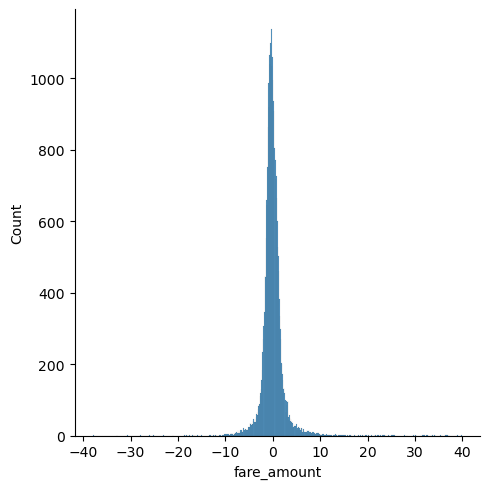

In [63]:
sns.displot(y_test-y_pred)

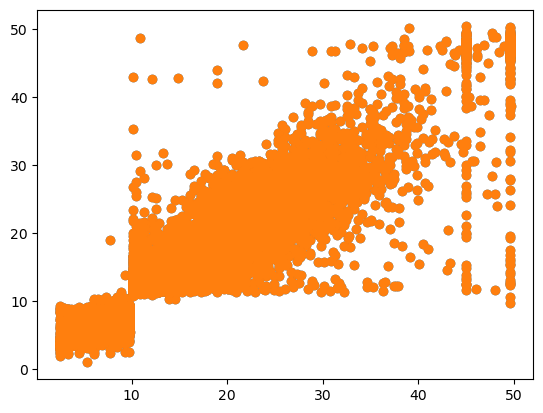

In [67]:
plt.scatter(y_test, y_pred)
plt.show()

### Hyperparameter Tuning:

In [68]:
from sklearn.model_selection import RandomizedSearchCV

In [70]:
# RandomizedSearchCV

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start=100, stop=1200, num=12)]
# Various learning rate parameters
learning_rate = ['0.05','0.1','0.2','0.3','0.5','0.6']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(5,30,num=6)]
# subsample parameter values
subsample = [0.7,0.6,0.8]
# Minimum child weight parameter
min_child_weight = [3,4,5,6,7]

In [71]:
# Create a Random grid:

random_grid = {'n_estimators' : n_estimators,
              'learning_rate' : learning_rate,
              'max_depth' : max_depth,
              'subsample' : subsample,
              'min_child_weight' : min_child_weight}

print(random_grid)

{'n_estimators': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1100, 1200], 'learning_rate': ['0.05', '0.1', '0.2', '0.3', '0.5', '0.6'], 'max_depth': [5, 10, 15, 20, 25, 30], 'subsample': [0.7, 0.6, 0.8], 'min_child_weight': [3, 4, 5, 6, 7]}


In [73]:
# let's use Random grid to search for best hyperparameter
import xgboost
regressor = xgboost.XGBRegressor()

In [74]:
xg_random = RandomizedSearchCV(estimator = regressor, param_distributions=random_grid, scoring='neg_mean_squared_error', n_iter=5, cv=5, verbose=2, random_state=42, n_jobs=-1)

## Implementing ANN:

In [94]:
# Importing Keras libraries and packages

import tensorflow.keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LeakyReLU, PReLU, ELU, Dropout
from tensorflow.keras.callbacks import EarlyStopping

In [95]:
NN_model = Sequential()

# The input layer
NN_model.add(Dense(128, kernel_initializer = 'normal', input_dim=X_train.shape[1], activation='relu'))

# The hidden layer
NN_model.add(Dense(256, kernel_initializer='normal', activation='relu'))
NN_model.add(Dense(256, kernel_initializer='normal', activation='relu'))
NN_model.add(Dense(256, kernel_initializer='normal', activation='relu'))

# The Output layer
NN_model.add(Dense(1, kernel_initializer='normal', activation='linear'))

# Compile the network
NN_model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])

#Defining Early Stopping Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

NN_model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_21 (Dense)            (None, 128)               1024      
                                                                 
 dense_22 (Dense)            (None, 256)               33024     
                                                                 
 dense_23 (Dense)            (None, 256)               65792     
                                                                 
 dense_24 (Dense)            (None, 256)               65792     
                                                                 
 dense_25 (Dense)            (None, 1)                 257       
                                                                 
Total params: 165,889
Trainable params: 165,889
Non-trainable params: 0
_________________________________________________________________


In [96]:
history = NN_model.fit(X_train, y_train, validation_split=0.33, epochs=30, batch_size=50, callbacks=[early_stopping])

Epoch 1/30
1206/1206 [==============================] - 7s 5ms/step - loss: 1.7973 - mean_absolute_error: 1.7973 - val_loss: 1.6117 - val_mean_absolute_error: 1.6117
Epoch 2/30
1206/1206 [==============================] - 6s 5ms/step - loss: 1.5581 - mean_absolute_error: 1.5581 - val_loss: 1.5160 - val_mean_absolute_error: 1.5160
Epoch 3/30
1206/1206 [==============================] - 6s 5ms/step - loss: 1.5224 - mean_absolute_error: 1.5224 - val_loss: 1.4891 - val_mean_absolute_error: 1.4891
Epoch 4/30
1206/1206 [==============================] - 6s 5ms/step - loss: 1.4970 - mean_absolute_error: 1.4970 - val_loss: 1.5105 - val_mean_absolute_error: 1.5105
Epoch 5/30
1206/1206 [==============================] - 6s 5ms/step - loss: 1.4768 - mean_absolute_error: 1.4768 - val_loss: 1.4365 - val_mean_absolute_error: 1.4365
Epoch 6/30
1206/1206 [==============================] - 6s 5ms/step - loss: 1.4653 - mean_absolute_error: 1.4653 - val_loss: 1.4802 - val_mean_absolute_error: 1.4802
Epoc

In [97]:
prediction = NN_model.predict(X_test)

938/938 [==============================] - 2s 2ms/step


C:\Users\kshit\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


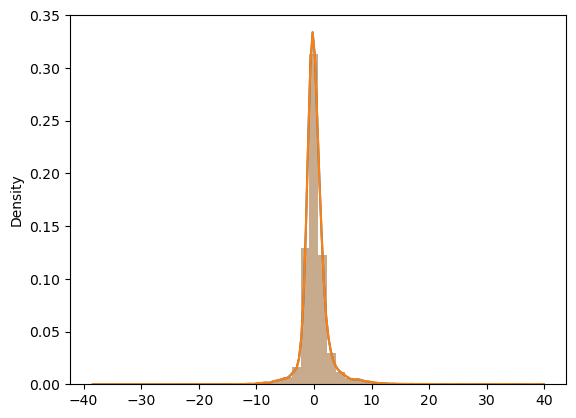

In [99]:
import seaborn as sns
sns.distplot(y_test.values.reshape(-1,1) - prediction)
plt.show()

## TPOTRegressor Automated Library

In [40]:
from tpot import TPOTRegressor

C:\Users\kshit\anaconda3\lib\site-packages\tpot\builtins\__init__.py:36: UserWarning: Warning: optional dependency `torch` is not available. - skipping import of NN models.
  warnings.warn("Warning: optional dependency `torch` is not available. - skipping import of NN models.")


In [44]:
tpot = TPOTRegressor(generations=2, population_size=10, verbosity=2, cv = 3, random_state=42, n_jobs=-1)
tpot.fit(X_train,y_train)

Optimization Progress:   0%|          | 0/30 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -6.876383272417347

Generation 2 - Current best internal CV score: -6.876383272417347

Best pipeline: RandomForestRegressor(input_matrix, bootstrap=True, max_features=0.7500000000000001, min_samples_leaf=11, min_samples_split=9, n_estimators=100)


TPOTRegressor(cv=3, generations=2, n_jobs=-1, population_size=10,
              random_state=42, verbosity=2)

In [45]:
print(tpot.score(X_test,y_test))

-6.349664922319318


In [46]:
tpot.export('tpot_taxiFareDocs_pipeline.py')

In [47]:
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

# NOTE: Make sure that the outcome column is labeled 'target' in the data file
tpot_data = pd.read_csv('final_data.csv', sep=',', dtype=np.float64)
features = tpot_data.drop('fare_amount', axis=1)
training_features, testing_features, training_target, testing_target = \
            train_test_split(features, tpot_data['fare_amount'], random_state=42)

In [48]:
# Average CV score on the training set was: -6.876383272417347
exported_pipeline = RandomForestRegressor(bootstrap=True, max_features=0.7500000000000001, min_samples_leaf=11, min_samples_split=9, n_estimators=100)
# Fix random state in exported estimator
if hasattr(exported_pipeline, 'random_state'):
    setattr(exported_pipeline, 'random_state', 42)

exported_pipeline.fit(training_features, training_target)
results = exported_pipeline.predict(testing_features)

In [55]:
testing_features.shape

(30000, 8)

In [56]:
testing_target.shape

(30000,)

In [54]:
results

array([ 4.41011133,  7.42512437,  6.78055741, ...,  7.26600166,
       13.73397457,  7.49873434])

In [57]:
testing_target

71787      4.1
67218      6.9
54066      5.7
7168      20.5
29618      4.5
          ... 
118354    14.9
63142      6.1
21228      6.1
12791     11.3
101905     9.7
Name: fare_amount, Length: 30000, dtype: float64

C:\Users\kshit\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

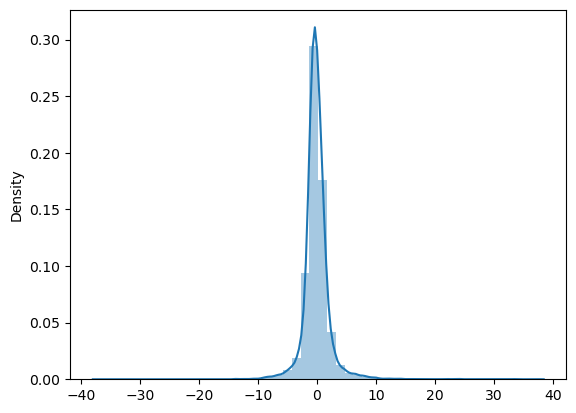

In [58]:
import seaborn as sns
sns.distplot(testing_target.values-results)

<AxesSubplot:>

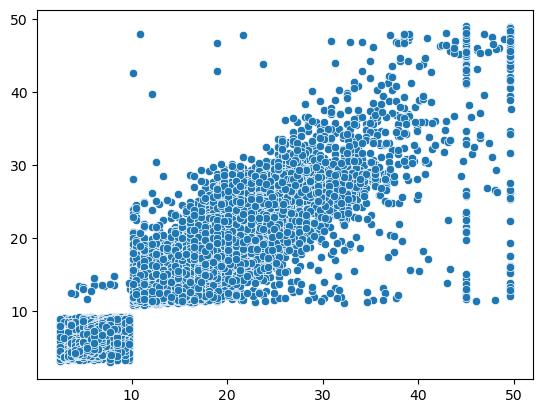

In [60]:
sns.scatterplot(testing_target.values, results)

In [67]:
from sklearn.metrics import mean_absolute_error,mean_squared_error

In [68]:
print("MAE: ", mean_absolute_error(testing_target, results))
print("RMSE: ", np.sqrt(mean_squared_error(testing_target, results)))

MAE:  1.406392724532602
RMSE:  2.521365604236278
